In [1]:
import math
import itertools
from functools import partial

import torch
import torch.nn.functional as F

In [2]:
import os
import sys
sys.path.insert(0, os.path.abspath('../dinov2/'))

In [3]:
from dinov2.utils.config import setup
from dinov2.models import build_model_from_cfg
from dinov2.fsdp import FSDPCheckpointer
from dinov2.train.ssl_meta_arch import SSLMetaArch
from dinov2.eval.setup import setup_and_build_model

/mnt/home/lparker/Documents/AstroFoundationModel/AstroDino/dinov2/dinov2/layers/swiglu_ffn.py:43: UserWarning: xFormers is available (SwiGLU)
  warnings.warn("xFormers is available (SwiGLU)")
/mnt/home/lparker/Documents/AstroFoundationModel/AstroDino/dinov2/dinov2/layers/attention.py:27: UserWarning: xFormers is available (Attention)
  warnings.warn("xFormers is available (Attention)")
/mnt/home/lparker/Documents/AstroFoundationModel/AstroDino/dinov2/dinov2/layers/block.py:33: UserWarning: xFormers is available (Block)
  warnings.warn("xFormers is available (Block)")


In [4]:
class config:
    output_dir = '/mnt/home/lparker/ceph/dino_training'
    config_file = '../astrodino/configs/astro_vitl12_simplified_mlp_momentum_snd.yaml'
    pretrained_weights = '/mnt/home/lparker/ceph/astroclip_final_refactor/eval/training_99999/teacher_checkpoint.pth'
    opts = []

In [5]:
model, dtype = setup_and_build_model(config())

I20240426 14:09:36 2180760 dinov2 config.py:59] git:
  sha: 2302b6bf46953431b969155307b9bed152754069, status: clean, branch: main

I20240426 14:09:36 2180760 dinov2 config.py:60] opts: ['train.output_dir=/mnt/home/lparker/ceph/dino_training']
output_dir: /mnt/home/lparker/ceph/dino_training
I20240426 14:09:36 2180760 dinov2 config.py:26] sqrt scaling learning rate; base: 0.0002, new: 5e-05
I20240426 14:09:36 2180760 dinov2 config.py:33] MODEL:
  WEIGHTS: ''
compute_precision:
  grad_scaler: true
  teacher:
    backbone:
      sharding_strategy: SHARD_GRAD_OP
      mixed_precision:
        param_dtype: fp16
        reduce_dtype: fp16
        buffer_dtype: fp32
    dino_head:
      sharding_strategy: SHARD_GRAD_OP
      mixed_precision:
        param_dtype: fp16
        reduce_dtype: fp16
        buffer_dtype: fp32
    ibot_head:
      sharding_strategy: SHARD_GRAD_OP
      mixed_precision:
        param_dtype: fp16
        reduce_dtype: fp16
        buffer_dtype: fp32
  student:
    bac

In [6]:
# Let's get some data as inputs
import numpy as np
import h5py
from PIL import Image as im

def sdss_rgb(imgs, bands, scales=None,
             m = 0.02):
    import numpy as np
    rgbscales = {'u': (2,1.5), #1.0,
                 'g': (2,2.5),
                 'r': (1,1.5),
                 'i': (0,1.0),
                 'z': (0,0.4), #0.3
                 }
    if scales is not None:
        rgbscales.update(scales)

    I = 0
    for img,band in zip(imgs, bands):
        plane,scale = rgbscales[band]
        img = np.maximum(0, img * scale + m)
        I = I + img
    I /= len(bands)
    Q = 20
    fI = np.arcsinh(Q * I) / np.sqrt(Q)
    I += (I == 0.) * 1e-6
    H,W = I.shape
    rgb = np.zeros((H,W,3), np.float32)
    for img,band in zip(imgs, bands):
        plane,scale = rgbscales[band]
        rgb[:,:,plane] = (img * scale + m) * fI / I

    rgb = np.clip(rgb, 0, 1)
    return rgb

def dr2_rgb(rimgs, bands, **ignored):
    return sdss_rgb(rimgs, bands, scales=dict(g=(2,6.0), r=(1,3.4), z=(0,2.2)), m=0.03)

In [7]:
# We should also look at how the images from the dataset look like

sys.path.insert(0, os.path.abspath('../'))

from astrodino.data.loaders import make_dataset

In [8]:
from torchvision.transforms import CenterCrop

test_dataset = make_dataset(
        dataset_str='LegacySurvey:split=test:root=/mnt/ceph/users/polymathic/external_data/astro/DECALS_Stein_et_al/:extra=""',
        transform=CenterCrop(144),
    )

I20240426 14:09:38 2180760 dinov2 loaders.py:86] using dataset: "LegacySurvey:split=test:root=/mnt/ceph/users/polymathic/external_data/astro/DECALS_Stein_et_al/:extra="""
I20240426 14:09:41 2180760 dinov2 loaders.py:91] # of dataset samples: 400,000


In [9]:
from tqdm import tqdm

embeddings = []
for i in tqdm(range(10_000//128)):
    images = torch.stack([test_dataset[j +i*128][0] for j in range(128)],  dim=0).cuda()
    embeddings.append(model(images).detach().cpu())
    del images
embeddings = np.concatenate(embeddings)

100%|██████████| 78/78 [08:02<00:00,  6.18s/it]


%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


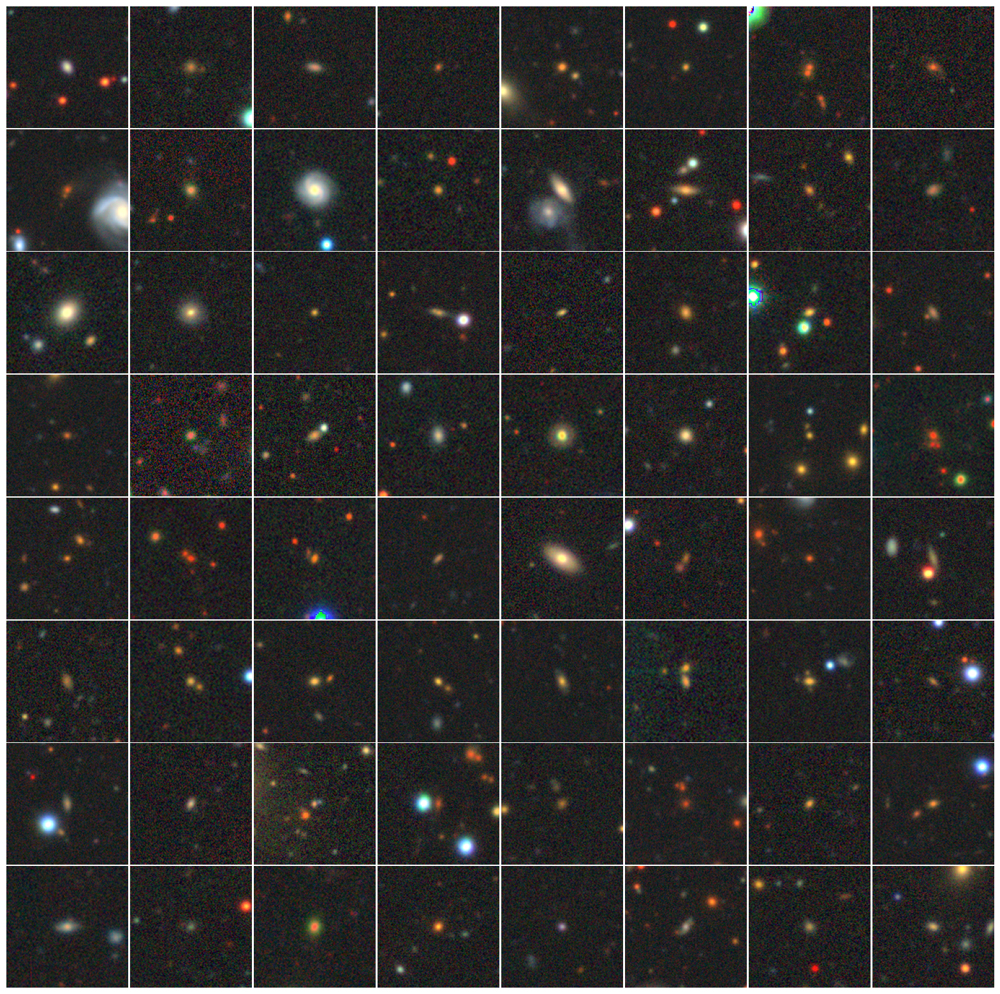

In [42]:
%pylab inline

figure(figsize=[20,20])
for i in range(8):
    for j in range(8):
        subplot(8, 8, i * 8 +j +1)
        imshow((test_dataset[i * 8 +j][0].cpu().T))
        axis('off')
        
plt.subplots_adjust(wspace=0.01, hspace=0.01)

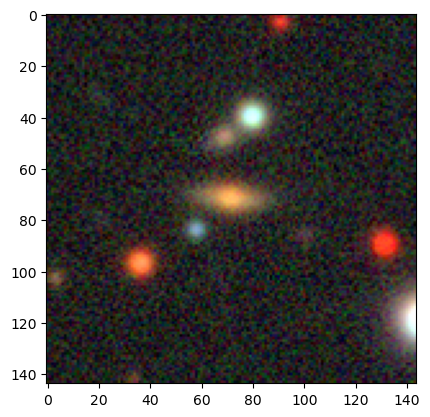

In [44]:
# Ok, so say we are interested in this object
test_im = np.array(test_dataset[13][0])
test_embed = model(torch.from_numpy(test_im[np.newaxis]).to('cuda')).detach().cpu()
imshow(test_im.T)

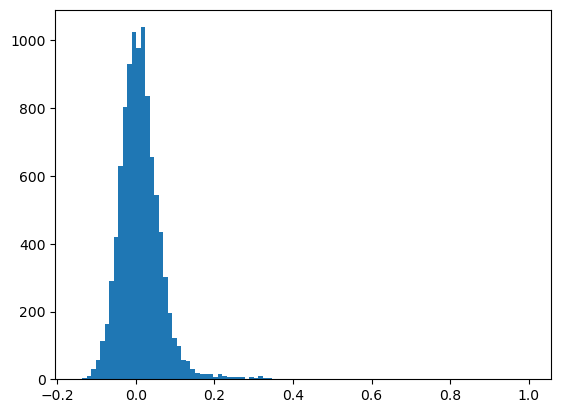

In [45]:
# Compute the cosine similarity between all these images
cos = torch.nn.CosineSimilarity(dim=1, eps=1e-6)
sim = cos(test_embed.reshape(1,-1), torch.from_numpy(embeddings)).cpu().numpy()
hist(sim,100);

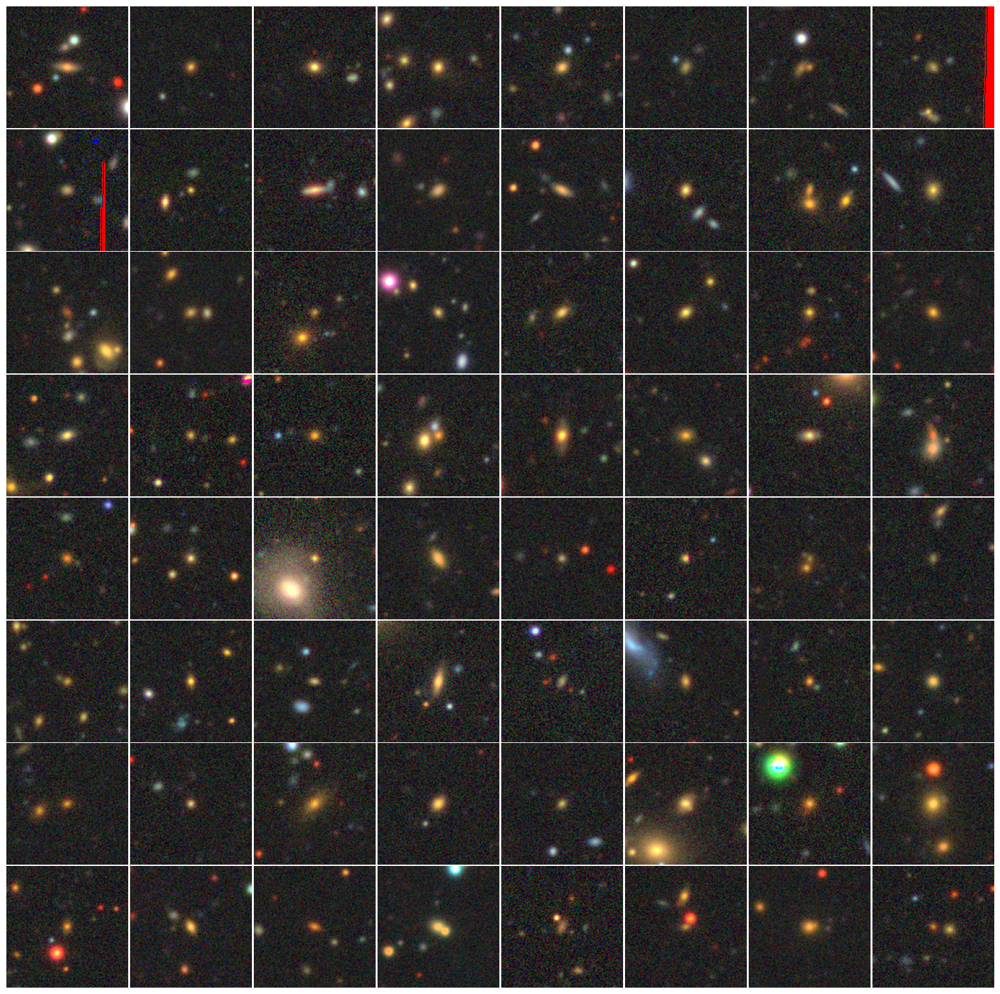

In [46]:
s = sim
inds = argsort(s)[::-1]
figure(figsize=[20,20])
for i in range(8):
    for j in range(8):
        subplot(8, 8, i * 8 +j +1)
        imshow(clip((test_dataset[inds[i * 8 +j]][0].cpu().T),0,1))
        axis('off')
plt.subplots_adjust(wspace=0.01, hspace=0.01)

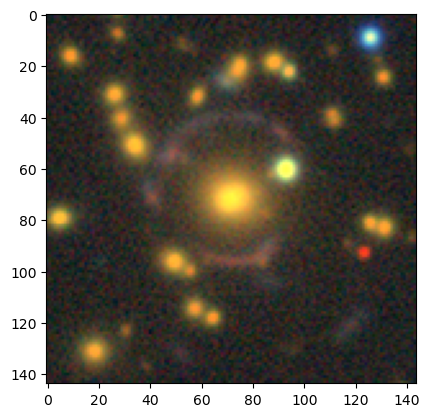

In [48]:
from astropy.io import fits

d = fits.getdata('test_image.fits')
test_im = dr2_rgb(d[:,56:-56,56:-56], "grz")
imshow(test_im)

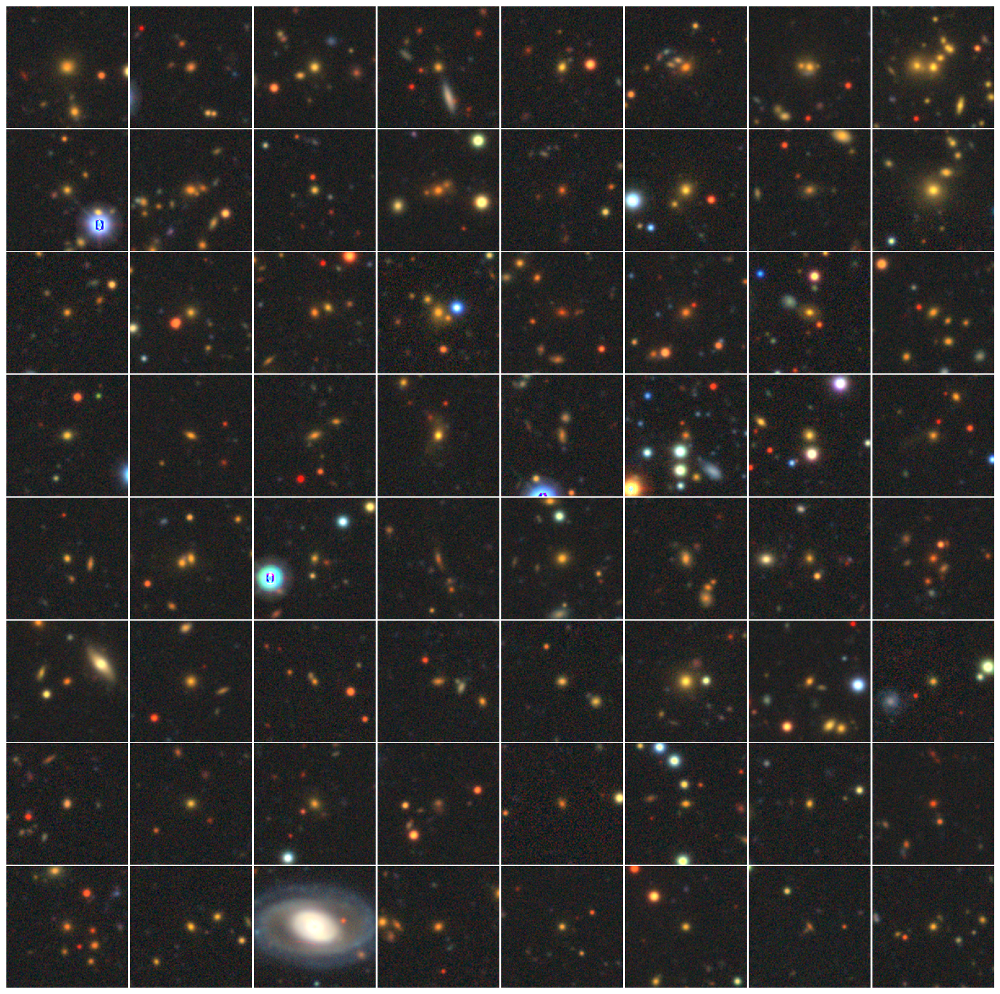

In [53]:
test_embed = model(torch.from_numpy(test_im.T[np.newaxis].astype('float32')).to('cuda') ).detach().cpu()
cos = torch.nn.CosineSimilarity(dim=1, eps=1e-6)
s = cos(test_embed.reshape(1,-1), torch.from_numpy(embeddings)).cpu().numpy()
inds = argsort(s)[::-1]
figure(figsize=[20,20])
for i in range(8):
    for j in range(8):
        subplot(8, 8, i * 8 +j +1)
        imshow((test_dataset[inds[i * 8 +j]][0].cpu().T))
        axis('off')
plt.subplots_adjust(wspace=0.01, hspace=0.01)